# Tesseract

## Libraries and their uses : 

PIL (Pillow) : Open the image

OpenCV : Change the image. Preprocess the image before sending to OCR

Tesseract(PyTesseract) : OCR the image

## *Opening a file using pillow*

In [62]:
from PIL import Image
im_file = "/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/page_01.jpg"
im = Image.open(im_file)
print(im)
print(im.size)
print(im.mode)

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1200x1522 at 0x171DC9E80>
(1200, 1522)
RGB


print(im) gives a lot of information about the image like image modes, size etc.

print(im.size) and print(im.mode) will give the size & image mode specifically

In [63]:
# im.show() # will open the image in a different window

In [64]:
# im.rotate(90).show()     # rotate the image and show in a different window. 

In [65]:
# can also save a file
from PIL import Image
im_file = "/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/page_01.jpg"
im = Image.open(im_file)
im.save("/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/page_01_copy.jpg")  # saves the file to the desired path

## *PreProcessing Images for OCR*

**OpenCV**

1. Opening the image using OpenCV

In [66]:
import cv2
import matplotlib.pyplot as plt
image_file = "/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/page_01.jpg"
img = cv2.imread(image_file)
# cv2.imshow("Original Image", img)
# cv2.waitKey(0)


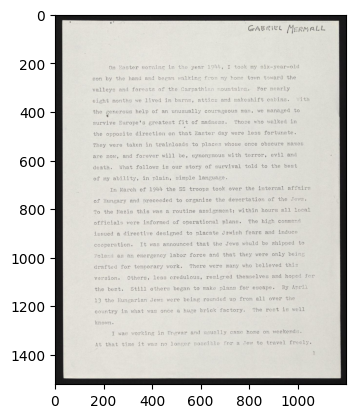

In [124]:
# The above method opens the image in a separate window. To open the image within here, we can use matplotlib as learned before. But that doesn't open the image in actual size.
import cv2
import matplotlib.pyplot as plt
image_file = "/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/page_01.jpg"
image = cv2.imread(image_file)
# convert the BGR into RGB
image_actual = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
plt.imshow(image_actual)

We can see that we've opened the image within here but the size is not actual. 
From google, we've obtained a code to open an image using plt in actual size.

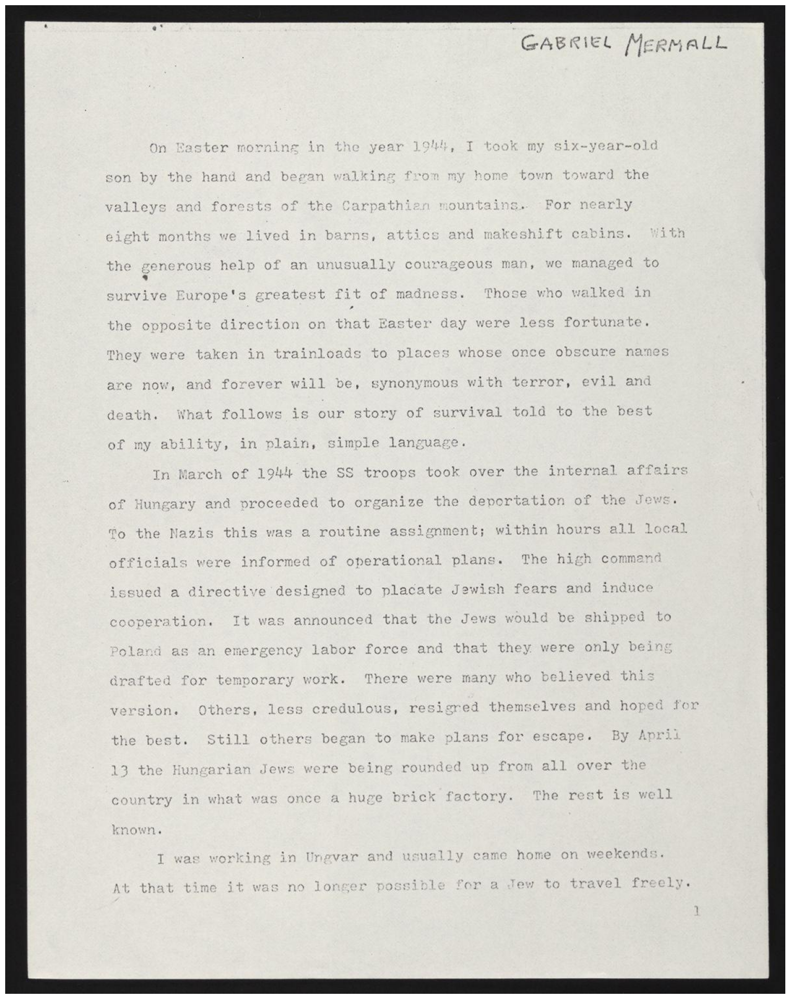

In [125]:
#https://stackoverflow.com/questions/28816046/
#displaying-different-images-with-actual-size-in-matplotlib-subplot
def display(im_path):
    dpi = 80
    im_data = plt.imread(im_path)

    height, width  = im_data.shape[:2]
    
    # What size does the figure need to be in inches to fit the image?
    figsize = width / float(dpi), height / float(dpi)

    # Create a figure of the right size with one axes that takes up the full figure
    fig = plt.figure(figsize=figsize)
    ax = fig.add_axes([0, 0, 1, 1])

    # Hide spines, ticks, etc.
    ax.axis('off')

    # Display the image.
    ax.imshow(im_data, cmap='gray')

    plt.show()
display(image_file)

By this, we opened the image in the actual size using plt

2. Inverted Images

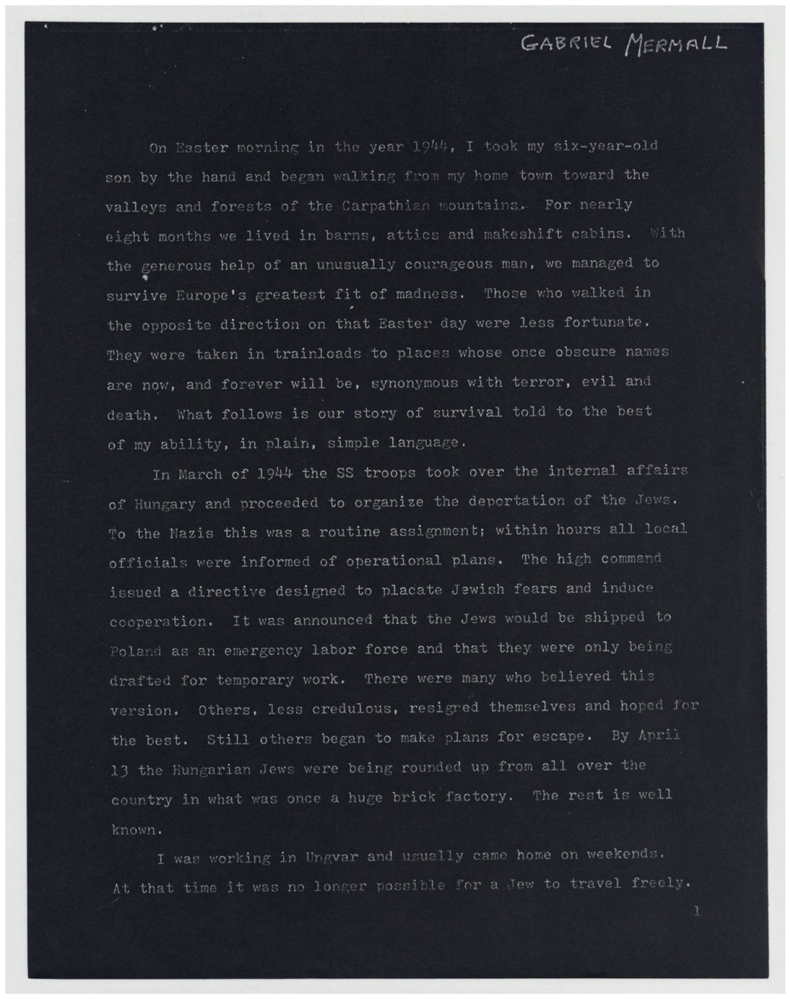

In [69]:
inverted_image = cv2.bitwise_not(img)
cv2.imwrite("/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/page_01_inverted.jpg", inverted_image) # saves the inverted image to the desired path
display("/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/page_01_inverted.jpg") # function defined earlier only


The darker areas in the original image are now light and vice versa

3. Rescaling

4. Binarization

Process to convert image into black and white

First, we'll convert the original image into grayscale

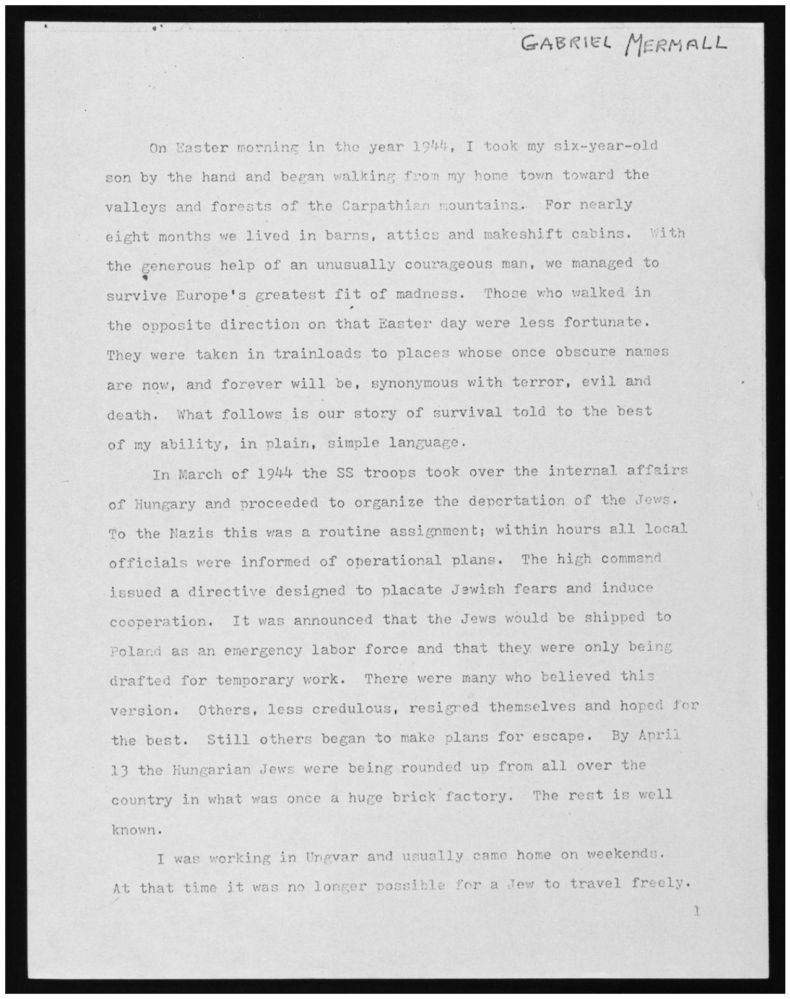

In [70]:
def grayscale(image):
    return cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

gray_image = grayscale(img)
cv2.imwrite("/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/page_01_gray.jpg", gray_image)

display("/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/page_01_gray.jpg")

Successfully converted into grayscale. Now we'll binarize it

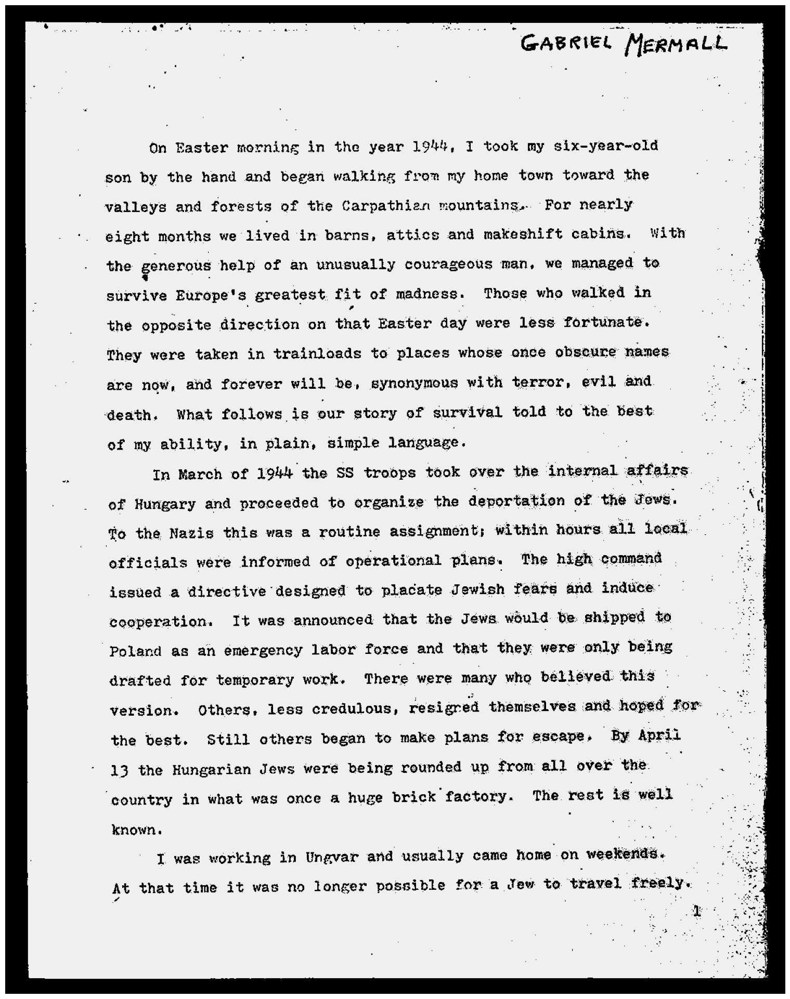

In [71]:
thresh, im_bw = cv2.threshold(gray_image, 210, 130, cv2.THRESH_BINARY)    # learn the syntax. The parameters are changed as per the output. Keep seeing the output and change parameters accordingly for clearer results. 
cv2.imwrite("/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/page_01_b&w.jpg", im_bw)
display("/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/page_01_b&w.jpg")


5. Noise Removal

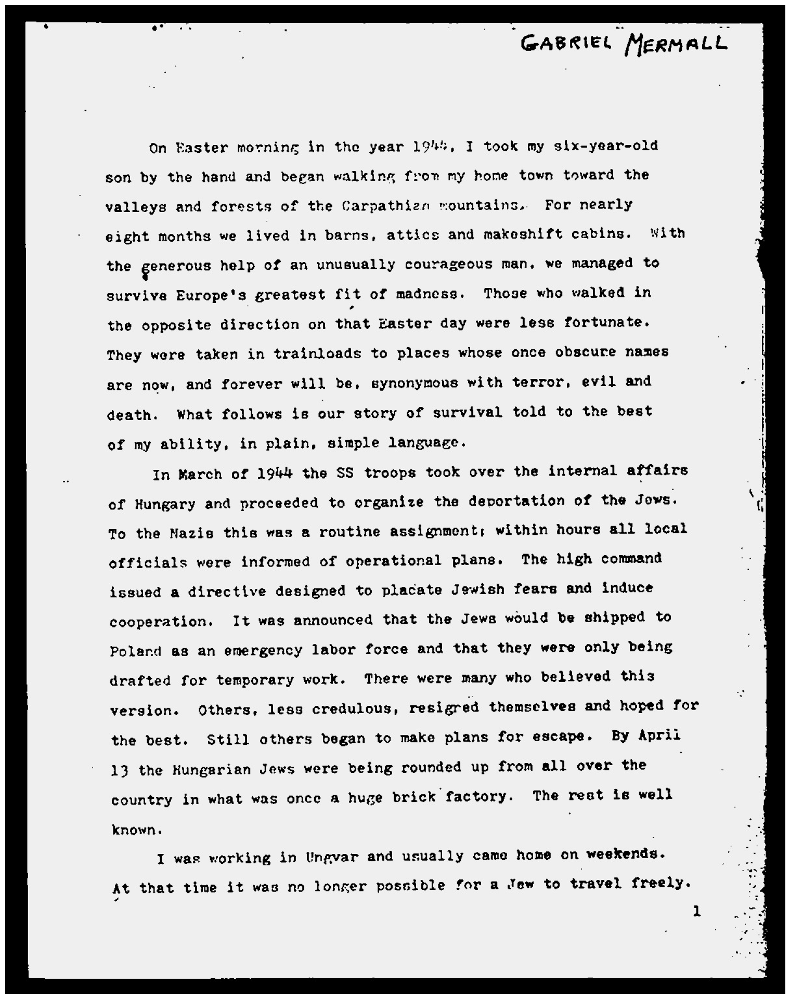

In [72]:
def noise_removal(image):
    import numpy as np
    kernel = np.ones((1,1), np.uint8)
    image = cv2.dilate(image, kernel, iterations =1)
    kernel = np.ones((1,1), np.uint8)
    image = cv2.erode(image, kernel, iterations=1)
    image = cv2.morphologyEx(image, cv2.MORPH_CLOSE, kernel)
    image = cv2.medianBlur(image,3)
    return (image)

no_noise = noise_removal(im_bw)
cv2.imwrite("/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/page_01_b&w_no_noise.jpg", no_noise)
display("/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/page_01_b&w_no_noise.jpg")

*Explaination :*
- A kernel is a filter/mask applied on images to apply effects like blurring, sharpening, edge detection etc. It is a small matrix and is moved across the image and a mathematical operation (typically called *convolution*) is applied between the kernel values and the pixel values of the images
- The kernel size and values define the nature of the operaton. For example, in a 3x3 kernel used for blurring, each pixel in the image is replaced by the average value of its surrounding pixels, which are weighed by the kernel values. The kernel used for basic operations is : 

1 1 1

1 1 1

1 1 1
- We've used a (1,1) kernel. A (1,1) kernel is effectively just a single pixel with a value of 1. This is a somewhat trivial kernel because it doesn't change the image when used in operations like dilation, erosion, or morphological closing. Using a (1,1) kernel means that the operations (dilate, erode, close) will apply to each pixel individually without considering its neighbors.
- Dilation with a (1,1) kernel and iterations=1 will leave the image unchanged because each pixel is just being "dilated" by itself. Erosion similarly will leave the image unchanged with a (1,1) kernel. Morphological Closing will have no effect with a (1,1) kernel.
- **np.ones((1,1), np.uint8)** : Creates a (1,1) matrix (essentially a single element array) filled with ones. The *np.uint8* is a data type in NumPy that stands for "unsigned 8-bit integer." This means each element in the array can hold an integer value from 0 to 255. This range is typical for image data, where 0 represents black and 255 represents white (in grayscale images), and values in between represent varying shades of gray. This ensures the values in the kernel match the data type of typical image arrays (0-255 range), ensuring compatibility during image processing operations.
- **cv2.dilate(image, kernel, iterations=1)** : Dilation increases the white region in the image or the size of the foreground object (Dilation adds pixels to the boundaries of objects in an image). Normally used for connecting disjointed parts of an object. 
- **cv2.erode(image, kernel, iterations=1)** : Erosion reduces the white region in the image or the size of the foreground object (Erosion removes pixels on object boundaries) Used for removing small white noises.
- **cv2.morphologyEx(image, cv2.MORPH_CLOSE, kernel)** : Closing operation helps to close small holes in the foreground objects. (Closing is a dilation followed by an erosion) (Morphological Closing)
- **cv2.medianBlur(image, 3)** : Reduces noise by taking the median of the neighboring pixels within a 3x3 window. Smooths the image and reduces salt-and-pepper noise, preserving edges better than other blurring techniques.
- **iterations** : Means how many times the process has to be done. 



6. Dilation and Erosion

In case we don't have the need to do morphological closing.

In cases when we have very thick letters or very thin letters which are causing troubles in OCR, then we do erosion or dilation respectively

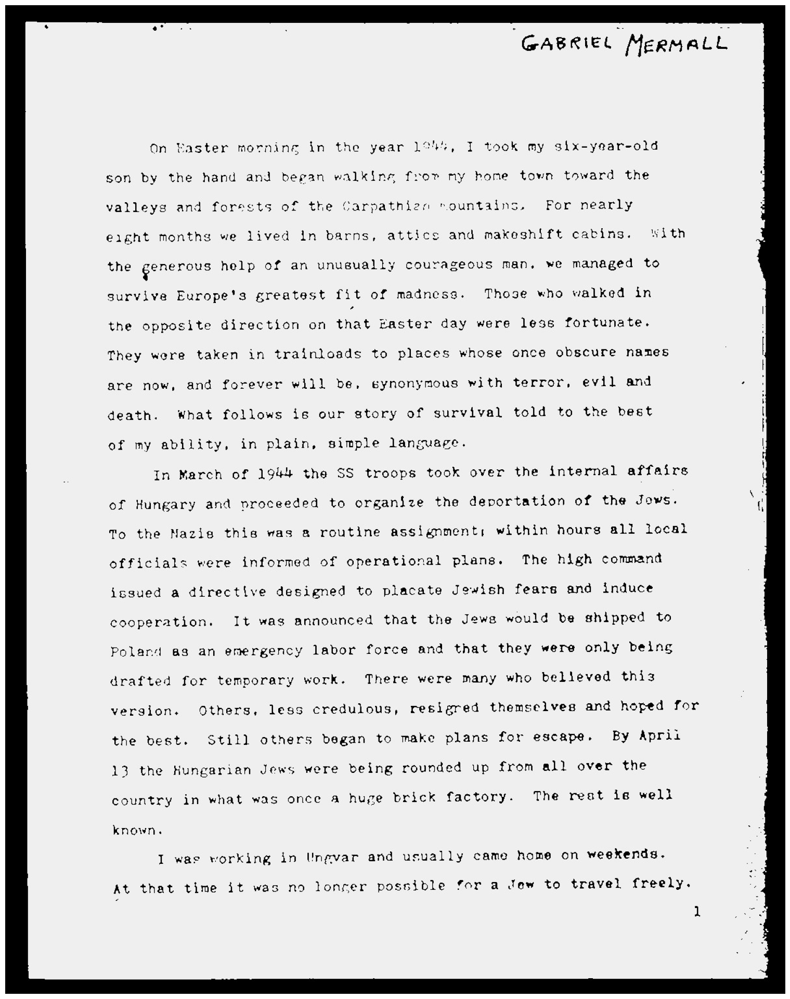

In [73]:
# To make the font thinner
def thin_font(image):
    import numpy as np
    image = cv2.bitwise_not(image)    # first, we invert the actual image. That is, dark in the actual image is inverted to lighter shade and vice versa
    kernel = np.ones((2,2), np.uint8) # the kernel values can be tweaked also. Giving (3,3) will cause the font to be even more thinner and like that the values can be changed. 
    image = cv2.erode(image, kernel, iterations=1)    # We apply the erosion on the inverted image. Erosion is done to reduce white spaces. The text in our actual image was black and hence we first inverted it, then applied the erosion filter on the inverted image. 
    image = cv2.bitwise_not(image)    # We invert the image back to original
    return (image)

eroded_image = thin_font(no_noise)
cv2.imwrite("/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/page_01_b&w_no_noise_thinnedfont.jpg", eroded_image)
display("/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/page_01_b&w_no_noise_thinnedfont.jpg")


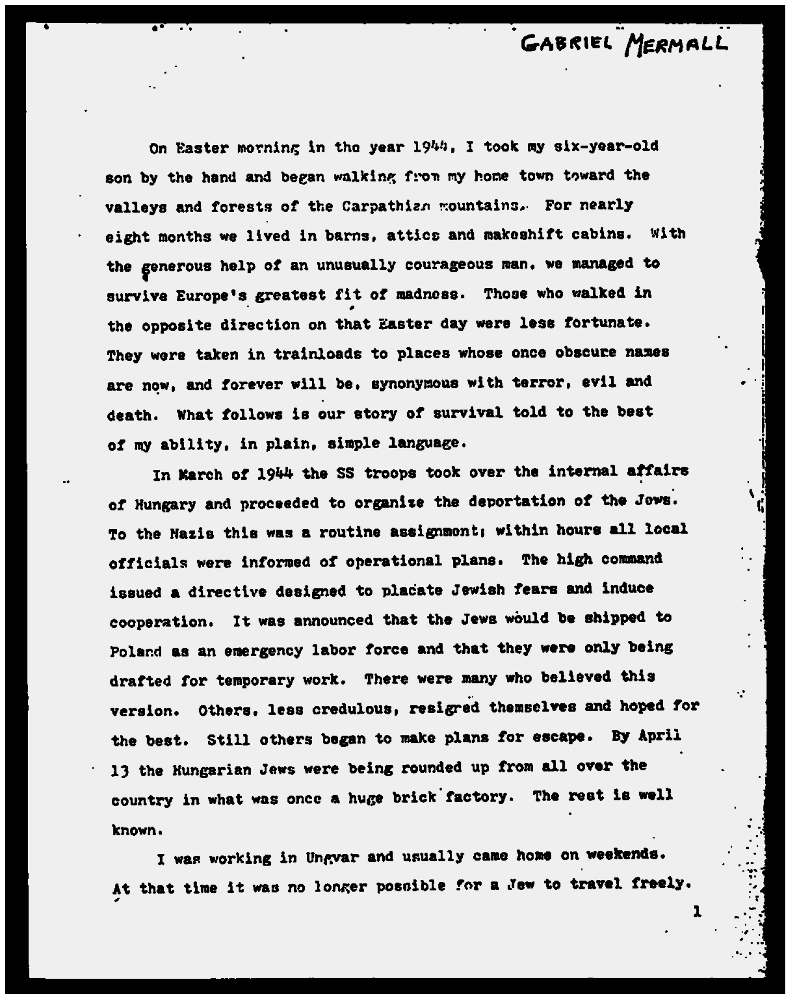

In [74]:
# To make the font thicker
def thick_font(image):
    import numpy as np
    image = cv2.bitwise_not(image)
    kernel = np.ones((2,2), np.uint8)
    image = cv2.dilate(image, kernel, iterations=1)
    image = cv2.bitwise_not(image)
    return (image)

dilated_image = thick_font(no_noise)
cv2.imwrite("/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/page_01_b&w_no_noise_thickedfont.jpg", dilated_image)
display("/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/page_01_b&w_no_noise_thickedfont.jpg")


7. Rotation/Deskewing

Done when we're dealing with PDF or images which are pivoted sideways. OCR is designed to work with vertically aligned text. Hence it is necessary to deskew a rotated image into vertical before proceding with OCR. 

**Ensure** that the skewed image that you're going to deskew **doesnot** contain any **borders**

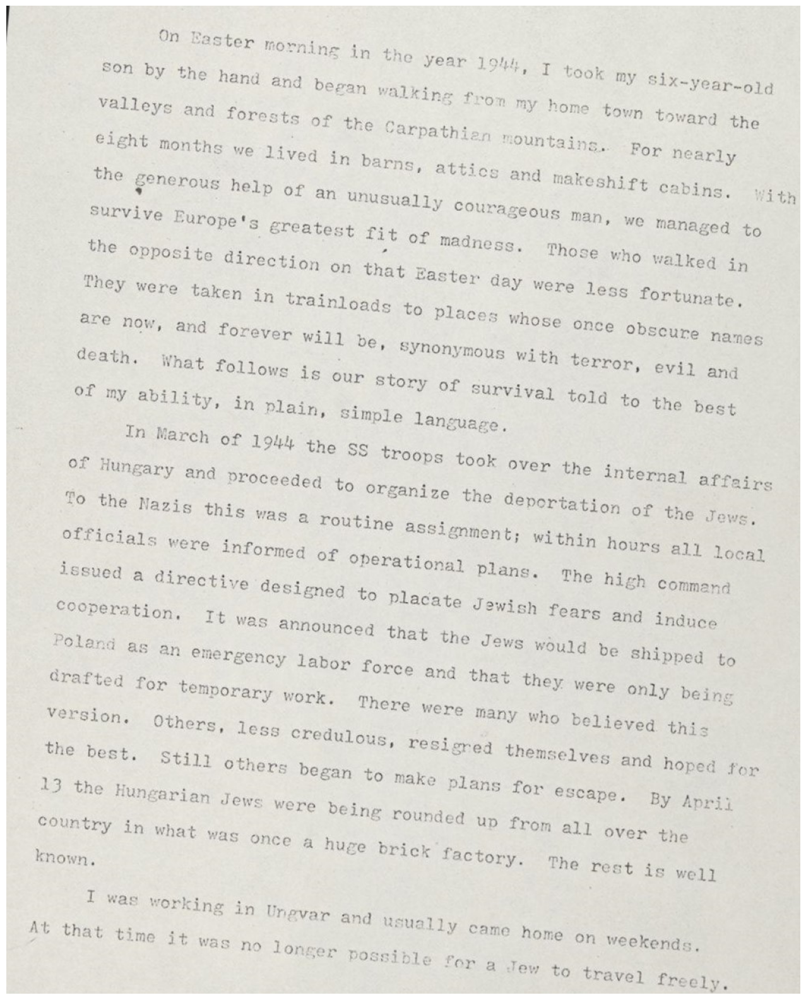

In [75]:
new = cv2.imread("/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/page_01_rotated.png")
display("/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/page_01_rotated.png")

In [76]:
#https://becominghuman.ai/how-to-automatically-deskew-straighten-a-text-image-using-opencv-a0c30aed83df
import numpy as np

def getSkewAngle(cvImage) -> float:
    # Prep image, copy, convert to gray scale, blur, and threshold
    newImage = cvImage.copy()
    gray = cv2.cvtColor(newImage, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(gray, (9, 9), 0)
    thresh = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]

    # Apply dilate to merge text into meaningful lines/paragraphs.
    # Use larger kernel on X axis to merge characters into single line, cancelling out any spaces.
    # But use smaller kernel on Y axis to separate between different blocks of text
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (30, 5))
    dilate = cv2.dilate(thresh, kernel, iterations=2)

    # Find all contours
    contours, hierarchy = cv2.findContours(dilate, cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)
    contours = sorted(contours, key = cv2.contourArea, reverse = True)
    for c in contours:
        rect = cv2.boundingRect(c)
        x,y,w,h = rect
        cv2.rectangle(newImage,(x,y),(x+w,y+h),(0,255,0),2)

    # Find largest contour and surround in min area box
    largestContour = contours[0]
    print (len(contours))
    minAreaRect = cv2.minAreaRect(largestContour)
    cv2.imwrite("temp/boxes.jpg", newImage)
    # Determine the angle. Convert it to the value that was originally used to obtain skewed image
    angle = minAreaRect[-1]
    if angle < -45:
        angle = 90 + angle
    return -1.0 * angle
# Rotate the image around its center
def rotateImage(cvImage, angle: float):
    newImage = cvImage.copy()
    (h, w) = newImage.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    newImage = cv2.warpAffine(newImage, M, (w, h), flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_REPLICATE)
    return newImage

In [77]:
# Deskew image
def deskew(cvImage):
    angle = getSkewAngle(cvImage)
    return rotateImage(cvImage, -1.0 * angle)

28


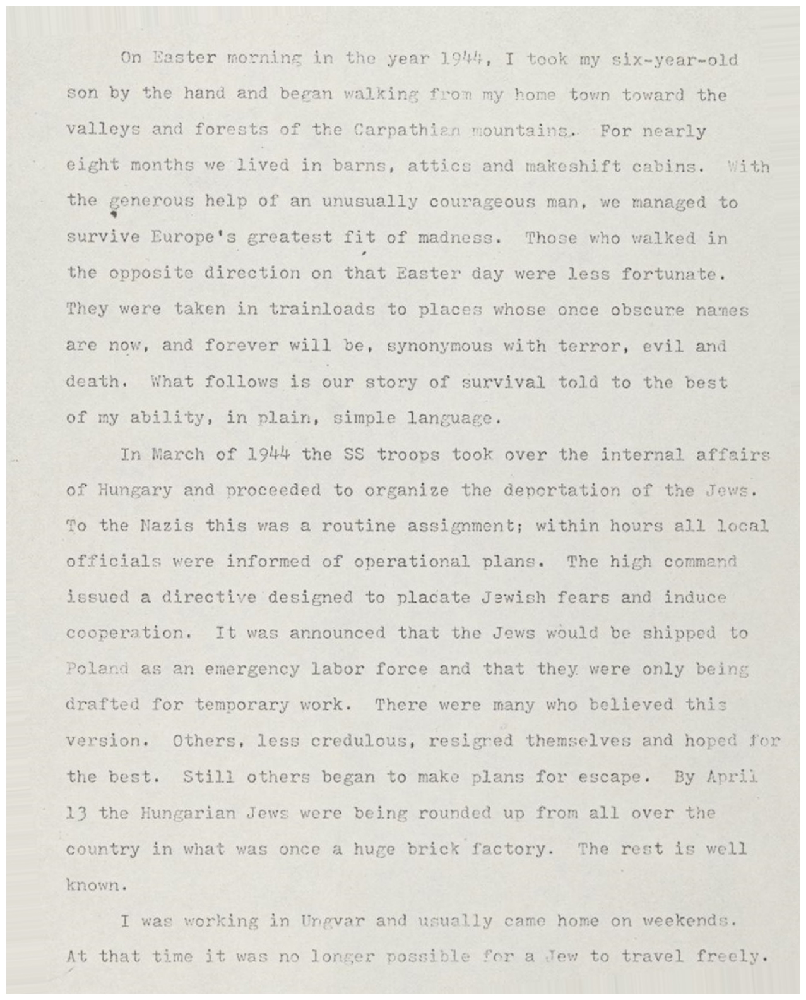

In [78]:
fixed = deskew(new)
cv2.imwrite("/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/page_01_rotated_now_deskewed.png", fixed)
display("/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/page_01_rotated_now_deskewed.png")

8. Removing Borders

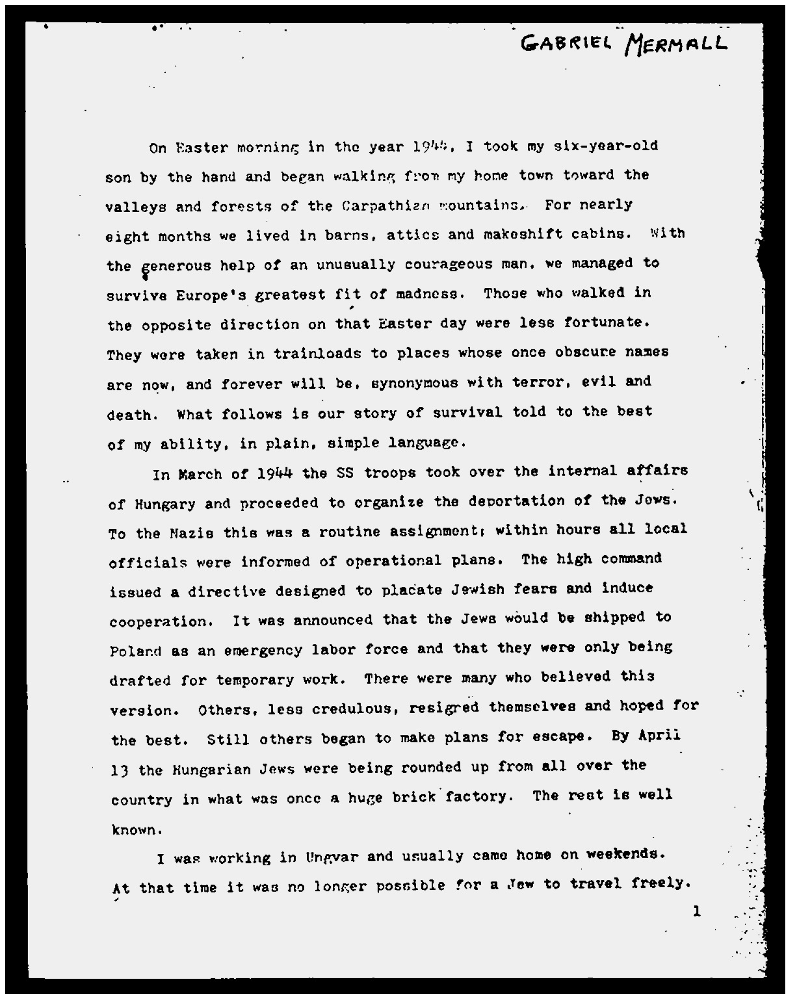

In [79]:
# displaying the no noise b&w image for convenience
display("/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/page_01_b&w_no_noise.jpg")

This method won't cause removal of borders with 100% efficiency but still works pretty well

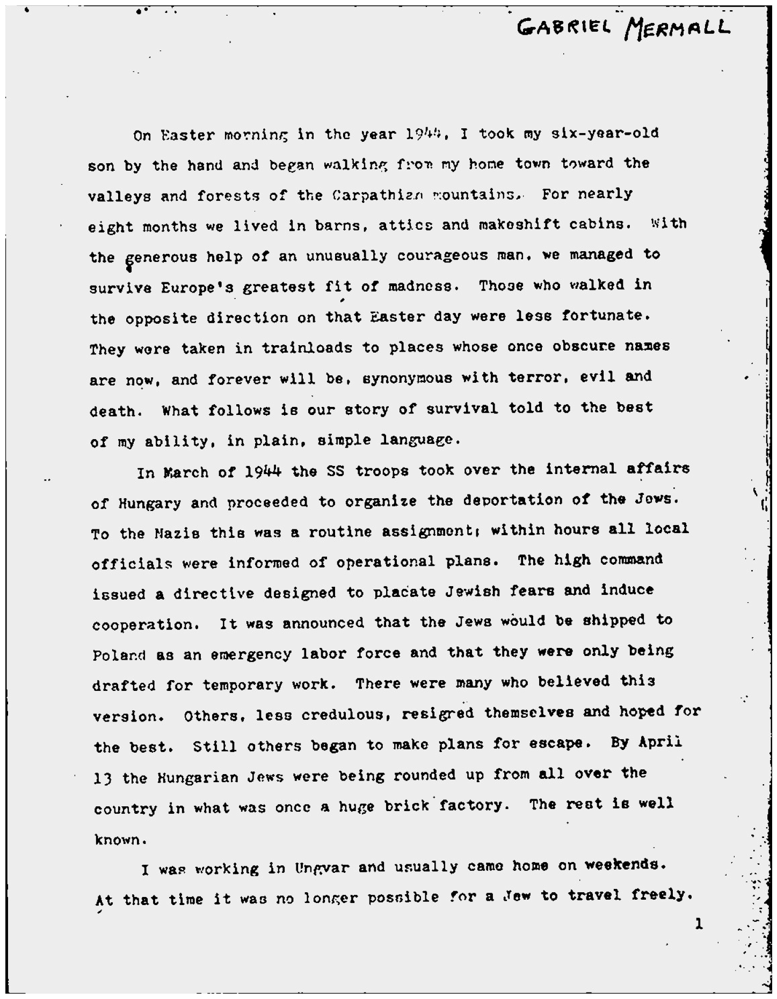

In [80]:
def remove_borders(image):
    contours, heirarchy = cv2.findContours(image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cntSorted = sorted(contours, key = lambda x:cv2.contourArea(x))
    cnt = cntSorted[-1]
    x, y, w, h = cv2.boundingRect(cnt)
    crop = image[y:y+h, x:x+w]
    return (crop)

no_borders = remove_borders(no_noise)
cv2.imwrite("/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/page_01_b&w_no_noise_removed_borders.jpg", no_borders)
display("/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/page_01_b&w_no_noise_removed_borders.jpg")


This is the image with the borders removed. 

9. Add a missing border

You should do this when your text is all up against the corners of the page. 
We need to do this because the models were trained with some borders. It would be hard for the model to identify the characters at the side of the page unless there is a white (or ay color same as the surface color) border

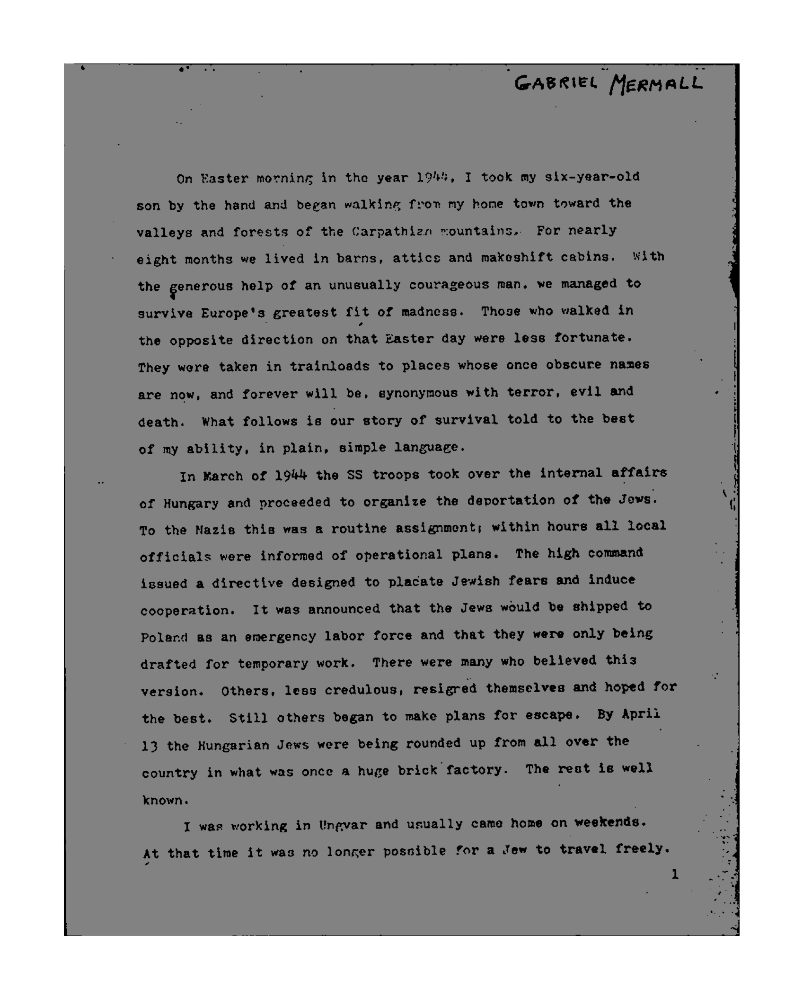

In [81]:
# We will add borders to the image we created in the last point, named no_borders
color = [255,255,255] # white
top, bottom, left , right = [100]*4
image_with_border = cv2.copyMakeBorder(no_borders, top, bottom, left, right, cv2.BORDER_CONSTANT, value=color)
cv2.imwrite("/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/page_01_b&w_no_noise_removed_borders_readded_borders.jpg", image_with_border)
display("/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/page_01_b&w_no_noise_removed_borders_readded_borders.jpg")

## *PyTesseract*

In [82]:
import pytesseract
from PIL import Image

In [83]:
img_file = "/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/page_01.jpg"
no_noise = "/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/page_01_b&w_no_noise.jpg"

In [84]:
img = Image.open(img_file)
ocr_result = pytesseract.image_to_string(img)
print(ocr_result)

We see that nothing happens. This is because we haven't processed the image before starting the OCR and hence the model wasn't able to identify the image properly

Hence, we shall process the image first, and then OCR. 

We already have pre-processed images, hence we'll use those

In [85]:
# Will use the no_noise image
img = Image.open(no_noise)
ocr_result = pytesseract.image_to_string(img)
print(ocr_result)

“GABRIEL Meamall

On Easter mocning in the year 19%, I took my six-year-old
son by the hand and began walking fron my home town toward the
valleys and forests of the Carpathizn mountains. For nearly
eight months we lived in barns, attics and makeshift cabins. With
the gone rous help of an unusually courageous man, we managed to
survive Europe's greatest fit of madness. Those who walked in
the opposite direction on that Easter day were lese fortunate.
They were taken in trainloads to places whose once obscure names
are now, and forever will be, synonymous with terror, evil and
death. What follows is our story of survival told to the best
of my ability, in plain, simple language.

In March of 1944 the SS troops took over the internal affairs
of Hungary and proceeded to organize the deportation of the dows.
To the Nazis thie was a routine assignment; within hours all local
officials were informed of operational plans. The high command
issued a directive designed to placate Jewish fears an

Errors will be there. OCR using ML is never 100% accurate

**Images where we need to read Column Wise**

In [86]:
import pytesseract
from PIL import Image

In [87]:
image_file = "/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/index_02.png"
img = Image.open(image_file)


In [88]:
ocr_result = pytesseract.image_to_string(img)
print(ocr_result)

INDEX NOMINUM.

SCRIPSIT KAROLUS HAMPE.

Maior numerus indicat paginam, minor lineam.

A.v. E.

Aaron 38, 20. 123, 18. 168, 6. 203, 38. |

Abacuc propheta 36,5. 319, 29. 373, 23.
Abagarus rex Edessenorum 382, 13.
Abdenago 585, 3.

Abel 26, 11.

Abigail 606, 6.

Abraham 26,18. 124,18. 133, 23, 2:
264. 302,13. 303, 13, 320, 40. 328, 1.
496, 22.

Absalon 102, 5.

Acgfredi v. Ecgfridus.

Achab rex 504, 1.

Achaz rex 504,1.

Achiel 606, 19.

Achilon 496, 26.

Adal-, Adel-, Adhel-, Aedel-, Aedel-,
‘Aedil-, Aed
Athel-, Athil-, Aethel-, Aethil-,
Ethel-.

Aedelbaldusabb.S. Petri Wiremuthen-
sis et S. Pauli Girwensis 110, 28.

Aedilberctus, Aedilberthus ep. Ha-
gulstadensis, antea ep. Candidae
casae sive Witernensis 27,43. 72,16.

Adalbertus, Aedilberctus sive Magus,
discipulus et capellanus Arnonis
archiep. Salisburg., postea_abb.
Ferrariensis 254, 1. 320, 41. 322, 19.
416, 418, 14, 422, 10.

Adalpertabb. [Tegernseensis ?]497,2s.

Adalbertus presb. monasterii S. Mar-
tini Turonensis 399, 3.

Ae

We can see the computer cannot read the file column wise. It is reading the file as a normal page and reading left to right. This is a case wherein reading pages can become an issue

We will use OpenCV and Pytesseract and divide the page into three separate columns and then read each column in order.

In [89]:
import pytesseract
import cv2
image = cv2.imread("/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/index_02.png")


In [90]:
# do some pre-processing
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
cv2.imwrite("/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/index_02_gray.png", gray)

blur = cv2.GaussianBlur(gray, (7,7), 0)
cv2.imwrite("/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/index_02_blur.png", blur)

thresh = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]
cv2.imwrite("/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/index_02_blur_thresh.png", thresh)

kernal = cv2.getStructuringElement(cv2.MORPH_RECT, (3,13))
cv2.imwrite("/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/index_02_blur_thresh_kernal.png", kernal)

dilate = cv2.dilate(thresh, kernal, iterations=1)
cv2.imwrite("/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/index_02_blur_thresh_kernal_dilated.png", dilate)

True

- **Convert to grayscale** :  Converts the image from BGR (Blue, Green, Red) color space to grayscale. Contour detection often works better on single-channel images because it simplifies the image data and reduces computational complexity.
- **Apply gaussian blue** : Applies Gaussian blur to the grayscale image. This step helps in reducing noise and smoothing the image, which is essential for better thresholding and contour detection. The (7,7) parameter defines the kernel size, which determines the extent of blurring.
- **Thresholding** : Converts the blurred grayscale image into a binary image, that is, image consisiting of pixels which are either 0 or 255. using thresholding. In thresholding , we have a threshold value T. In our image which needs to be binarised, any pixel intensity greater than T is set to a particular value and any pixel intensity smaller than T is set to another value. This is how the binarisation is done. Two types of thresholding are there : inv and otsu. 

Read More here : https://pyimagesearch.com/2021/04/28/opencv-thresholding-cv2-threshold/ 

We've used the OTSU thresholding here, so it doesn't matter for us to take the thresholds. OTSU method automatically detects the threshold as per it's own convenience. 

- **Kernel** :  Creates a rectangular structuring element (kernel) with a size of 3x13. This kernel is used for morphological operations. In morphological operations, the kernel defines the neighborhood of pixels over which the operation is applied. The cv2.MORPH_RECT parameter specifies a rectangular shape. Hence in short , Defines the shape and size of the neighborhood for morphological operations.
- **Dilation** : Applies the dilation operation to the thresholded image using the previously defined kernel. Enhances and connects features to make contours more detectable. So basically, dilation adds pixels to the boundaries of objects in a binary image. The amound and direction of this addition are controlled by the size and shape of the kernel

In [91]:
'''
Read this code first. 
The next block is the same code, but just ROI has also been generated in the same loop.
So basically, this code in this block was written first, interpreted properly. 
Then, i added the ROI generation code line in the for loop.
Hence i will run the next block only. This block will be commented out
'''


"""
# create the contours

# importing and finding contours
cnts = cv2.findContours(dilate, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE) # This function finds contours in a bianry image. Dilate, RETR_EXTERNAL retrives only the extreme outer contours. CHAIN_APPROX_SIMPLE compresses horizontal, vertical and diagonal segments and leaves only their end points
cnts = cnts[0] if len(cnts)==2 else cnts[1]
cnts = sorted(cnts, key=lambda x:cv2.boundingRect(x)[0])  # contours are sorted by the x-coordinate of their bouding rectangle's top left corner. To ensure that contours are processed from left to right

# Filtering and drawing rectangles
for c in cnts:       # iterate through each contour
    x,y,w,h = cv2.boundingRect(c)     # Calculate the bouding rectangle for each contour. X and y are the coordinates of the top-left corner, while w and h are the width and height of the rectangle
    if h>300 and w>30:                # apply this filter to process only those contours where h is more than 300 pixels and w is more than 30 pixels. This is because otherwise the model was identifying a lot of unneccesary contours, we only need the three big columns
        cv2.rectangle(image, (x,y), (x+w, y+h), (36,255,12), 2)     # draw a rectangle around the filtered contours. Color of contours set to green and thickness of 2 pixels.

cv2.imwrite("/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/index_02_bbox.png", image)
"""

True

In [94]:
# create the contours

# importing and finding contours
cnts = cv2.findContours(dilate, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE) 
cnts = cnts[0] if len(cnts)==2 else cnts[1]
cnts = sorted(cnts, key=lambda x:cv2.boundingRect(x)[0])  
results = []
# Filtering and drawing rectangles
for c in cnts:      
    x,y,w,h = cv2.boundingRect(c)     
    if h>300 and w>30: 
        roi = image[y:y+h, x:x+w]
        cv2.imwrite("/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/index_02_roi.png", roi)       # will give us the last column in the index image.         
        cv2.rectangle(image, (x,y), (x+w, y+h), (36,255,12), 2)
        ocr_result = pytesseract.image_to_string(roi)
        ocr_result = ocr_result.split("\n")
        for item in ocr_result:
            results.append(item)     

cv2.imwrite("/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/index_02_bbox.png", image)
print(results)

['A. v. E.', '', 'Aaron 38, 20. 123, 18. 168, 6. 203, 38.', 'Abacuc propheta 36,5. 319, 29. 373, 23.', 'Abagarus rex Edessenorum 382, 13.', 'Abdenago 585, 3.', 'Abel 26, 11.', 'Abigail 606, 6.', 'Abraham 26,18, 124,18. 133, 23.', '264. 302, 13. 303, 13. 320, 40.', '496, 22.', 'Absalon 102, 5.', 'Acgfredi v. Ecgtridus.', 'Achab rex 504, 1.', 'Achaz rex 504, 1.', 'Achiel 606, 19.', 'Achilon 496, 26.', 'Adal-, Adel-, Adhel-, Aedel-, Aed', '', 'Aedil-, Aedil- Edel-, Edil-, Athal-,', 'Athel-, Athil-, Aethel-, Aethil-,', 'Ethel-.', 'Aedelbaldusabb.S. PetriWiremuthen-', 'sis et S. Pauli Girwensis 110, 28.', 'Aedilberctus, Aedilberthus ep. Ha-', 'gulstadensis, antea ep. Candidae', 'casae sive Witernensis 27,43. 72,16.', 'Adalbertus, Aedilberctus sive Magus,', 'discipulus et capellanus Arnonis', 'archiep. Salisburg., postea_abb.', 'Ferrariensis 254, 1. 320, 41. 322, 19.', '416. 418, 14. 422, 10.', 'Adalpertabb.[Tegernseensis ?]497,23.', 'Adalbertus presb. monasterii S. Mar-', 'tini Turonensis 3

In [99]:
# From now on, the code written is written on hit and trial basis, regularly seeing the ouputs and improving them.
# For watching each step, refer to : https://www.youtube.com/watch?v=y1iw8c2CEgw&list=PL2VXyKi-KpYuTAZz__9KVl1jQz74bDG7i&index=8
entities = []
for item in results:
    item = item.strip().replace("\n", "")
    item = item.split(" ")[0]   # we just need the first names. Hence we will split from the first instance of a space " ". The first instance is denoted by the [0]
    if len(item) > 2:
        if item[0].isupper() and item[0] == "A" and "-" not in item:    # only print if first letter is uppar, because first name in the list is in upper only and the section of names is of A.
            item = item.split(".")[0].replace(".", "").replace(";", "") # to replace the commas and semicolons with nothing
            entities.append(item)

entities = list(set(entities)) # to remove duplicates
entities.sort() # to sort the entities
print(entities)






['Aaron', 'Abacuc', 'Abagarus', 'Abdenago', 'Abel', 'Abigail', 'Abraham', 'Absalon', 'Acgfredi', 'Achab', 'Achaz', 'Achiel', 'Achilon', 'Adalbertus', 'Adalbertus,', 'Adalgarius', 'Adalgisus', 'Adalhardus,', 'Adalmondus,', 'Adalpert', 'Adalpertabb', 'Adalwinus', 'Adam', 'Adaula', 'Adelgisa', 'Adelperga', 'Adhelricus', 'Adoredus,', 'Adrianus', 'Adriaticum', 'Aedelbaldusabb', 'Aedelhardus,', 'Aedelredus,', 'Aedelwaldus,', 'Aedilberctus,', 'Aedilburga,', 'Aedilthyda', 'Aedilthyda,', 'Aegesippus', 'Aegil', 'Aegyptiacascola,', 'Aegyptii,', 'Aegyptus,', 'Aeine,', 'Aelberhtus', 'Aelfvaldus,', 'Aelim', 'Aeneades', 'Aesculapius,', 'Aesne', 'Aethelfleda', 'Aethelhardus,', 'Aethilredus,', 'Aethiluuinus', 'Aethiopia', 'Africa', 'Africanus,', 'Agar', 'Agareni,', 'Agathensis', 'Aginus']


Hence we were able to create a list of all the names out of the index page. 

**Another example of image wehre we need to remove Footnotes and other extra things**

In [100]:
import pytesseract
import cv2

In [101]:
image = cv2.imread("/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/sample_mgh.png")
base_image = image.copy()

In [106]:
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
blur = cv2.GaussianBlur(gray, (7,7), 0)
thresh = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]
kernal = cv2.getStructuringElement(cv2.MORPH_RECT, (3,50))
dilate = cv2.dilate(thresh, kernal, iterations=1)
cv2.imwrite("/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/sample_mgh_dilated.png", dilate)


True

In [107]:
cnts = cv2.findContours(dilate,cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
cnts = cnts[0] if len(cnts) == 2 else cnts[1]
cnts = sorted(cnts, key=lambda x:cv2.boundingRect(x)[1])


In [110]:
for c in cnts:
    x,y,w,h = cv2.boundingRect(c)
    if h>200 and w>250:
        roi = base_image[y:y+h, x:x+w]
        cv2.rectangle(image, (x,y), (x+w, y+h), (36,255,12), 2)
    
cv2.imwrite("/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/sample_mgh_sample_boxes.png", image)



True

This has created the basic big contour.

This is much better than the original sample_mgh text. We can see the improvements by comparing the results of the ocr on sample_mgh and sample_mgh_sample_boxes below. 

In [109]:
# printing the ocr_result of the main file sample_mgh
ocr_result_original = pytesseract.image_to_string(base_image)
print(ocr_result_original)


18 ALCVINI EPISTOLAE. 1.

1.

773-786 Alevinus amicum in monasterium se abditurum confirmat. De Benedicto monacho.
773—786.
Cod. H fol. 61'—62'.
Edd. F211, J. 8, — Migne col. 485.

DILECTISSIMO* AMICO TOTIUS PROSPERITATIS PRAESENTIS ET AETERNAE
BEATITUDINIS PERPETUAM SALUTEM.

Magna mihi laetitia est de bona voluntate vestra, quam audivi a fratre nostro

Benedicto! in vobis esse. Opto atque Deum deprecor, ut citius cum omni convenien-

Port tia perficiatur. Scriptum est enim: ‘Ne tardes converti ad dominum Deum; quia
nescis, quid ventura pariat dies’, Erue te de harum carcere tribulationum, quae in

Ps. 33, 20.hoe mundo fidelium animos torquere solent®; sicut scriptum est: ‘Multae tribulationes
iustorum’; ut, quod sequitur, tibi evenire merearis: ‘Sed de his omnibus liberavit eos

cf. Luc.9,62. Dominus’. Et cave diligentissime, ne qua te, aratrum Domini tenentem, iniustitia
retro revocet. Nemo miles sarcinis alienis onustus ad bella bene procedit, nisi armis
tantummodo victricibus, vel

In [111]:
# printing the ocr_result of the new file with contours sample_mgh_sample_boxes
ocr_result_new = pytesseract.image_to_string(roi)
print(ocr_result_new)

ae

Alevinus amicum in monasterium se abditurum confirmat, De Benedicto monacho.
773—786.

Cod. H fol. 61'—62'.

Edd. F211, J. 8, — Migne col. 485.

DILECTISSIMO* AMICO TOTIUS PROSPERITATIS PRAESENTIS ET AETERNAE
BEATITUDINIS PERPETUAM SALUTEM.

Magna mihi laetitia est de bona voluntate vestra, quam audivi a fratre nostro
Benedicto! in vobis esse. Opto atque Deum deprecor, ut citius cum omni convenien-
tia perficiatur. Scriptum est enim: ‘Ne tardes converti ad dominum Deum; quia
nescis, quid ventura pariat dies’, Erue te de harum carcere tribulationum, quae in
hoe mundo fidelium animos torquere solent®; sicut scriptum est: ‘Multae tribulationes
iustorum’; ut, quod sequitur, tibi evenire merearis: ‘Sed de his omnibus liberavit eos
Dominus’. Et cave diligentissime, ne qua te, aratrum Domini tenentem, iniustitia
retro revocet. Nemo miles sarcinis alienis onustus ad bella bene procedit, nisi armis
tantummodo victricibus, vel ad defensionem sui vel ad laesionem adversarii.

Omnia quae vobis

We can see the improvements. But here also, the footnote is involved. We don't need that. We will also improve on that. 

We will now remove the footnote. 

We have to implement some changes to the above code only. So, i'm not doing changes to the above code, i'm copying the above code again below and doing the changes. I will name the files as file_name_2 because they're going to be regenerated again. 

In [119]:
import pytesseract
import cv2
image = cv2.imread("/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/sample_mgh_copy.png")
im_h, im_w, im_d = image.shape  # grabbing the dimensions of the image
print(image.shape)
base_image_2 = image.copy()
# we will remove the footnote from the fact that the main data and the footnote is divided by a long horizontal line. So we will try to create a contour around that horizontal line.
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
blur = cv2.GaussianBlur(gray, (7,7), 0)
thresh = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]
# create the rectangular structuring element and dilate
kernal = cv2.getStructuringElement(cv2.MORPH_RECT, (50,10))   # we are working on the horizontal line, so it is long and thin. Hence we use parameter like 50,10
dilate = cv2.dilate(thresh, kernal, iterations=1)
cv2.imwrite("/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/sample_mgh_dilated_2.png", dilate)

# create contours
cnts = cv2.findContours(dilate,cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
cnts = cnts[0] if len(cnts) == 2 else cnts[1]
cnts = sorted(cnts, key=lambda x:cv2.boundingRect(x)[1])


for c in cnts:
    x,y,w,h = cv2.boundingRect(c)
    if h<30 and w>250:
        roi = base_image[y:y+h, x:x+w]
        cv2.rectangle(image, (x,y), (x+w, y+h), (36,255,12), 2)
    
cv2.imwrite("/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/sample_mgh_sample_boxes_2.png", image)

(1672, 1236, 3)


True

This has created a contour around the line separating the footnote and the main body. 

Now to separate the data above the footer line, we shall implement a few changs to the above code only. So I will just copy and paste the code and implement the changes in here only. I will change the file names accordingly. 

In [121]:
import pytesseract
import cv2
image = cv2.imread("/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/sample_mgh_copy.png")
im_h, im_w, im_d = image.shape  # grabbing the dimensions of the image
print(image.shape)
base_image_2 = image.copy()
# we will remove the footnote from the fact that the main data and the footnote is divided by a long horizontal line. So we will try to create a contour around that horizontal line.
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
blur = cv2.GaussianBlur(gray, (7,7), 0)
thresh = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]
# create the rectangular structuring element and dilate
kernal = cv2.getStructuringElement(cv2.MORPH_RECT, (50,10))   # we are working on the horizontal line, so it is long and thin. Hence we use parameter like 50,10
dilate = cv2.dilate(thresh, kernal, iterations=1)
cv2.imwrite("/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/sample_mgh_dilated_3.png", dilate)

# create contours
cnts = cv2.findContours(dilate,cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
cnts = cnts[0] if len(cnts) == 2 else cnts[1]
cnts = sorted(cnts, key=lambda x:cv2.boundingRect(x)[1])


for c in cnts:
    x,y,w,h = cv2.boundingRect(c)
    if h<30 and w>250:
        roi = base_image[0:y+h, 0:x+im_w]
        cv2.rectangle(image, (x,y), (x+w, y+h), (36,255,12), 2)
    
cv2.imwrite("/Users/ayaanchoudhury/Desktop/Python Coding/Tesseract/sample_mgh_without_footnote.png", roi)

(1672, 1236, 3)


True

Hence the final image formed is the image above the footnote.

*Hence, this is how we can **remove** the footnote from the main body in an image.*